<a href="https://colab.research.google.com/github/maheepmouli/IAAC2024_tutorials/blob/main/WOOD_ID__MERGE_FILE.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Tue Mar 12 16:11:36 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   40C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 54.8 gigabytes of available RAM

You are using a high-RAM runtime!


In [ ]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [ ]:
# Pip install method (recommended)

!pip install ultralytics==8.0.196

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (8 CPUs, 51.0 GB RAM, 34.9/201.2 GB disk)


In [ ]:
from ultralytics import YOLO

from IPython.display import display, Image

### **WOOD - DETECTION (DATA SET)**

---



---



In [ ]:
import os
HOME2 = os.getcwd()
print(HOME2)

/content


In [ ]:
!mkdir {HOME2}/datasets
%cd {HOME2}/datasets
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="70KVCANfN8TojfJfSOLw")
project = rf.workspace("wood-type-detection").project("wood-types")
version = project.version(3)
dataset = version.download("yolov8")


/content/datasets
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.4/71.4 kB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 7.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 20.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 8.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 36.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 6.7 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.9.0.80
    Uninstalling opencv-python-headless-4.9.0.80:
      Successfully uninstalled opencv-python-headless-4.9.0.80
  Attempting uninstall: idna
    Found existing installation: idna 3.6
    Uninstalling idna-3.6:
      Successfully uninstalled idna-3.6
  Attempting uninstall: cycler
    Found existing installation: cycler 0.12.1
    Uninstalling cycler-0.12.1:
      Successfully unin

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Wood-types-3 in yolov8:: 100%|██████████| 5526/5526 [00:01<00:00, 4990.28it/s]


In [ ]:
%cd /content/Wood-types-3
!yolo classify mode=train model=yolov8s.pt data="/content/datasets/Wood-types-3/data.yaml" epochs=10 imgsz=800 plots=True


[Errno 2] No such file or directory: '/content/Wood-types-3'
/content/datasets
100% 21.5M/21.5M [00:00<00:00, 47.3MB/s]
WARNING ⚠️ conflicting 'task=classify' passed with 'task=detect' model. Ignoring 'task=classify' and updating to 'task=detect' to match model.
New https://pypi.org/project/ultralytics/8.1.27 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/datasets/Wood-types-3/data.yaml, epochs=10, patience=50, batch=16, imgsz=800, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_h

In [ ]:
!ls /content/datasets/runs/detect/train/

args.yaml					    PR_curve.png	   val_batch0_pred.jpg
confusion_matrix_normalized.png			    R_curve.png		   val_batch1_labels.jpg
confusion_matrix.png				    results.csv		   val_batch1_pred.jpg
events.out.tfevents.1710251071.7e09c937bba2.1557.0  results.png		   val_batch2_labels.jpg
F1_curve.png					    train_batch0.jpg	   val_batch2_pred.jpg
labels_correlogram.jpg				    train_batch1.jpg	   weights
labels.jpg					    train_batch2.jpg
P_curve.png					    val_batch0_labels.jpg


In [ ]:
%cd {HOME}

!yolo task=detect mode=val model=/content/datasets/runs/detect/train/weights/best.pt data=/content/datasets/Wood-types-3/data.yaml

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11127132 parameters, 0 gradients, 28.4 GFLOPs
val: Scanning /content/datasets/Wood-types-3/valid/labels.cache... 225 images, 3 backgrounds, 0 corrupt: 100% 225/225 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 15/15 [00:06<00:00,  2.28it/s]
                   all        225        223      0.955      0.977      0.982      0.942
                 Eiken        225         56      0.968          1      0.995      0.946
                Grenen        225         36      0.943      0.972      0.976      0.924
               Meranti        225         72      0.975      0.986      0.983      0.968
                 Vuren        225         59      0.935      0.949      0.971      0.932
Speed: 1.6ms preprocess, 13.6ms inference, 0.0ms loss, 3.5ms postprocess per image
Results saved to runs/detect/val


/content


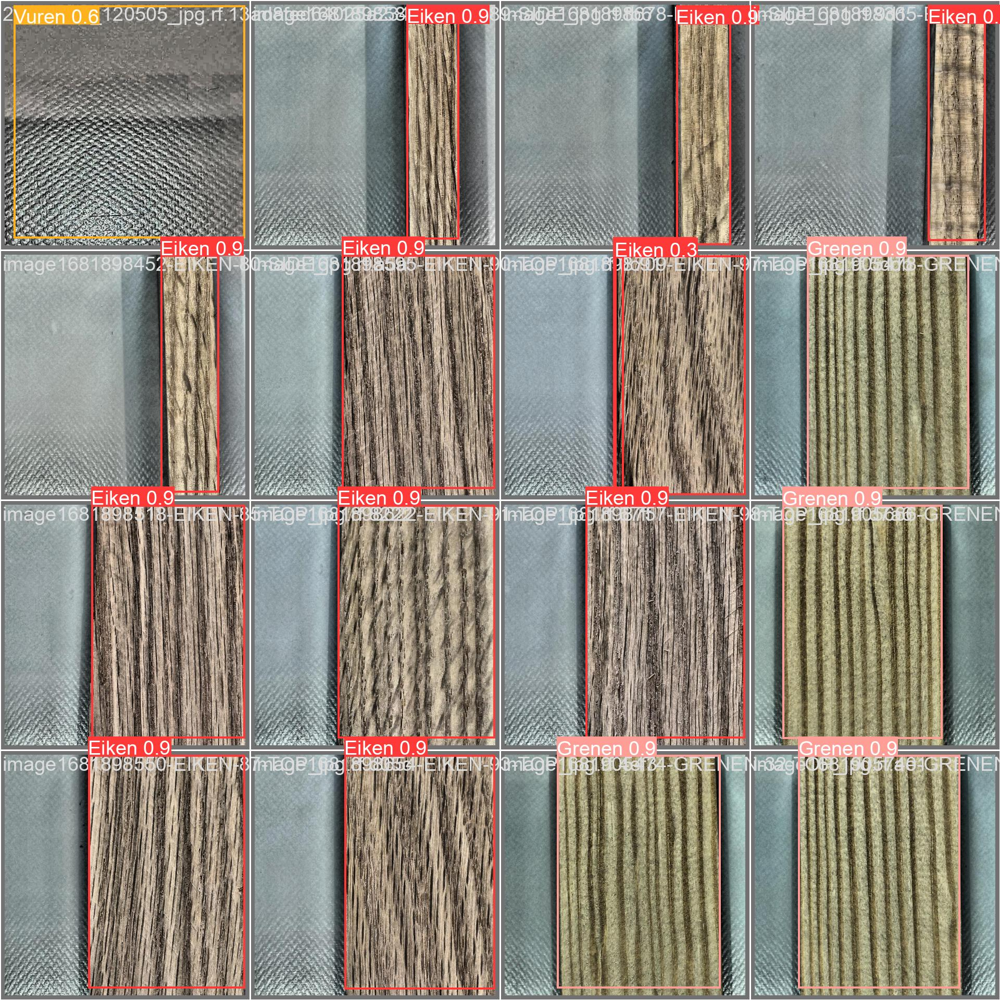

In [ ]:
%cd {HOME}
Image(filename=f'/content/datasets/runs/detect/train/val_batch0_pred.jpg', width=800)

In [ ]:
%cd {HOME}

!yolo task=detect mode=val model=/content/datasets/runs/detect/train/weights/best.pt data=/content/datasets/Wood-types-3/data.yaml

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11127132 parameters, 0 gradients, 28.4 GFLOPs
val: Scanning /content/datasets/Wood-types-3/valid/labels.cache... 225 images, 3 backgrounds, 0 corrupt: 100% 225/225 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 15/15 [00:06<00:00,  2.44it/s]
                   all        225        223      0.955      0.977      0.982      0.942
                 Eiken        225         56      0.968          1      0.995      0.946
                Grenen        225         36      0.943      0.972      0.976      0.924
               Meranti        225         72      0.975      0.986      0.983      0.968
                 Vuren        225         59      0.935      0.949      0.971      0.932
Speed: 1.7ms preprocess, 13.3ms inference, 0.0ms loss, 3.0ms postprocess per image
Results saved to runs/detect/val2

In [ ]:
%cd {HOME}
!yolo task=detect mode=predict model=/content/datasets/runs/detect/train/weights/best.pt conf=0.15 source=/content/IMAGE save=True

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11127132 parameters, 0 gradients, 28.4 GFLOPs

image 1/3 /content/IMAGE/IMAGE1.jpg: 800x608 1 Vuren, 69.5ms
image 2/3 /content/IMAGE/IMAGE2.jpg: 800x608 1 Eiken, 1 Grenen, 19.6ms
image 3/3 /content/IMAGE/IMAGE3.jpg: 800x576 1 Vuren, 67.1ms
Speed: 3.9ms preprocess, 52.1ms inference, 194.1ms postprocess per image at shape (1, 3, 800, 576)
Results saved to runs/detect/predict
💡 Learn more at https://docs.ultralytics.com/modes/predict


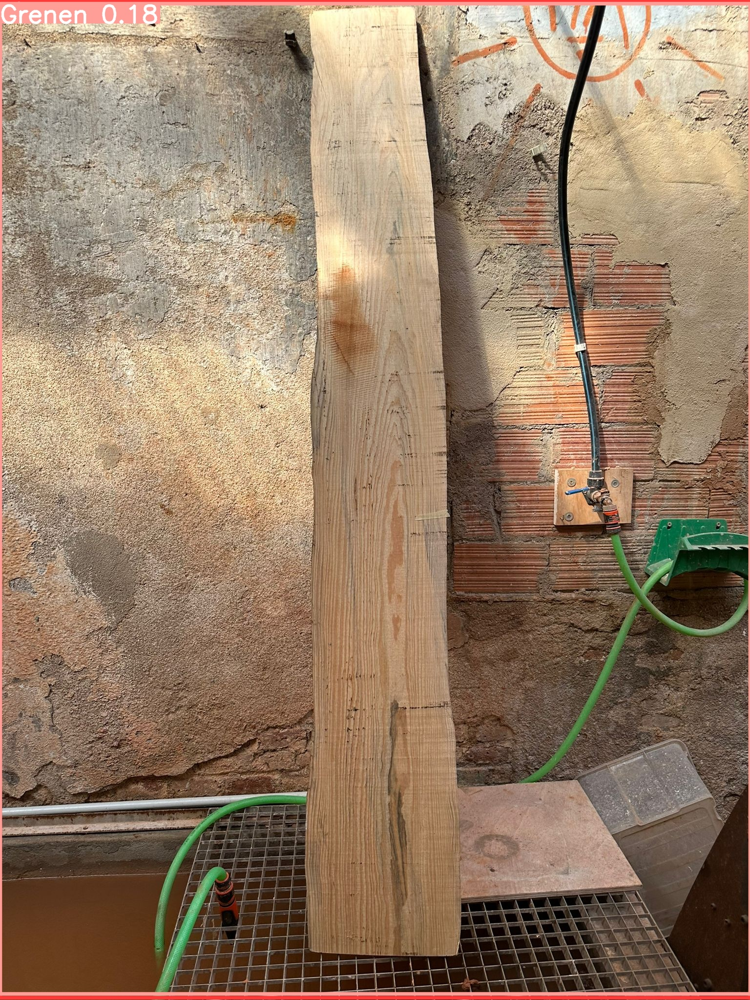

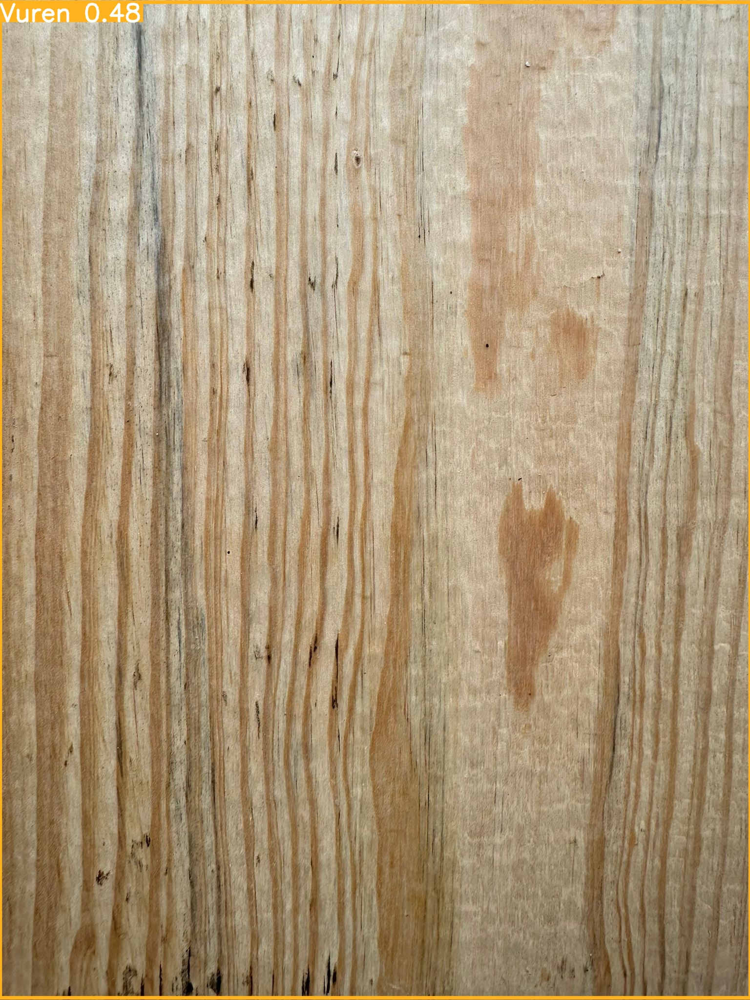

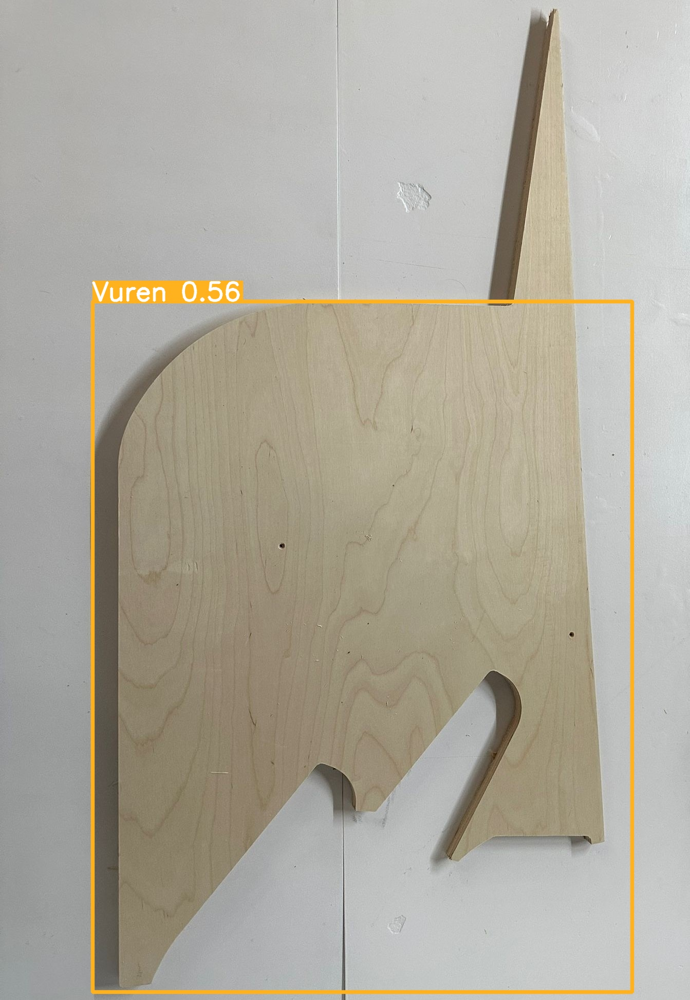

In [ ]:
import glob
from IPython.display import Image, display

# Define the directory where your JPG format images are located
directory = "/content/runs/detect/predict"

# Use glob to find all JPG format images in the directory
jpg_files = glob.glob(f"{directory}/*.jpg")

# Display each JPG format image
for jpg_file in jpg_files:
    display(Image(filename=jpg_file))

### **WOOD - DETECTION (DATA SET)**

---



---



In [ ]:
!mkdir {HOME}/datasets
%cd {HOME}/datasets
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="qUwlRCBkZhzJfhpRdMOS")
project = rf.workspace("asdasd-boz3q").project("wood-0nvcu")
version = project.version(1)
dataset = version.download("yolov8")


mkdir: cannot create directory ‘/content/datasets’: File exists
/content/datasets
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Wood-1 in yolov8:: 100%|██████████| 660/660 [00:00<00:00, 8116.44it/s]


In [ ]:
%cd {HOME}

!yolo task=detect mode=train model=yolov8s.pt data={dataset.location}/data.yaml epochs=25 imgsz=800 plots=True

/content
100% 21.5M/21.5M [00:00<00:00, 378MB/s]
New https://pypi.org/project/ultralytics/8.1.27 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/datasets/Wood-1/data.yaml, epochs=25, patience=50, batch=16, imgsz=800, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=Fa

In [ ]:
!ls {HOME}/runs/detect/train/

args.yaml					    PR_curve.png	train_batch227.jpg
confusion_matrix_normalized.png			    R_curve.png		train_batch2.jpg
confusion_matrix.png				    results.csv		val_batch0_labels.jpg
events.out.tfevents.1710238343.bf9a11da7132.1154.0  results.png		val_batch0_pred.jpg
F1_curve.png					    train_batch0.jpg	val_batch1_labels.jpg
labels_correlogram.jpg				    train_batch1.jpg	val_batch1_pred.jpg
labels.jpg					    train_batch225.jpg	weights
P_curve.png					    train_batch226.jpg


In [ ]:
%cd {HOME}

!yolo task=detect mode=val model={HOME}/runs/detect/train/weights/best.pt data={dataset.location}/data.yaml

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11125971 parameters, 0 gradients, 28.4 GFLOPs
val: Scanning /content/datasets/Wood-1/valid/labels.cache... 62 images, 0 backgrounds, 0 corrupt: 100% 62/62 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 4/4 [00:03<00:00,  1.07it/s]
                   all         62        112      0.662      0.491      0.577      0.402
Speed: 4.1ms preprocess, 35.8ms inference, 0.0ms loss, 9.7ms postprocess per image
Results saved to runs/detect/val
💡 Learn more at https://docs.ultralytics.com/modes/val


/content


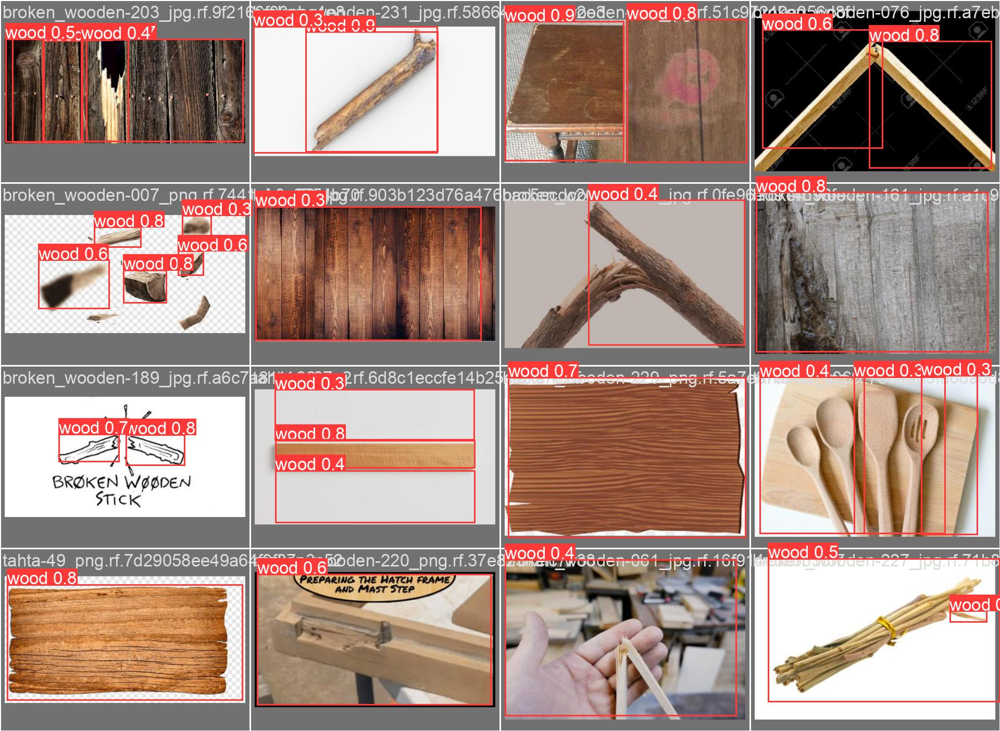

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train/val_batch0_pred.jpg', width=800)

In [ ]:
%cd {HOME}

!yolo task=detect mode=val model={HOME}/runs/detect/train/weights/best.pt data={dataset.location}/data.yaml

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11125971 parameters, 0 gradients, 28.4 GFLOPs
val: Scanning /content/datasets/Wood-1/valid/labels.cache... 62 images, 0 backgrounds, 0 corrupt: 100% 62/62 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 4/4 [00:03<00:00,  1.02it/s]
                   all         62        112      0.662      0.491      0.577      0.402
Speed: 4.1ms preprocess, 32.6ms inference, 0.0ms loss, 15.9ms postprocess per image
Results saved to runs/detect/val2
💡 Learn more at https://docs.ultralytics.com/modes/val


In [ ]:
%cd {HOME}
!yolo task=detect mode=predict model={HOME}/runs/detect/train/weights/best.pt conf=0.15 source={dataset.location}/test/images save=True

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11125971 parameters, 0 gradients, 28.4 GFLOPs

WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/35 /content/datasets/Wood-1/test/images/broken_wooden-004_jpg.rf.aa31a8325dff2999baf3abfe30db76f9.jpg: 544x800 1 wood, 80.0ms
image 2/35 /content/datasets/Wood-1/test/images/broken_wooden-006_jpg.rf.8f6c491990b65a6d09385a41dc17f027.jpg: 608x800 2 woods, 71.6ms
image 3/35 /content/datasets/Wood-1/test/images/broken_wooden-010_jpg.rf.9c20441bbaf812978a093e575b0265c3.jpg: 544x800 1 wood, 18.8ms
image 4/35 /content/datasets/Wood-1/test/images/broken_wooden-034_jpg.rf.dcd8277829d0dfa8a8bd52386a6d73a7.jpg: 800x800 3 woods, 23.1ms
image 5/35 /content/datasets/Wood-1/test/images/broken_wooden-044_jpg.rf.58ad5eb9d5eb216017d1c412ee9b8123.jpg: 608x800 4 woods, 19.3ms
image 6/35 /content/datasets/Wood-1/test/images/broken_wooden-078_jpg.rf.7a7a18abf1ff70d339d4d6972a2f5437.

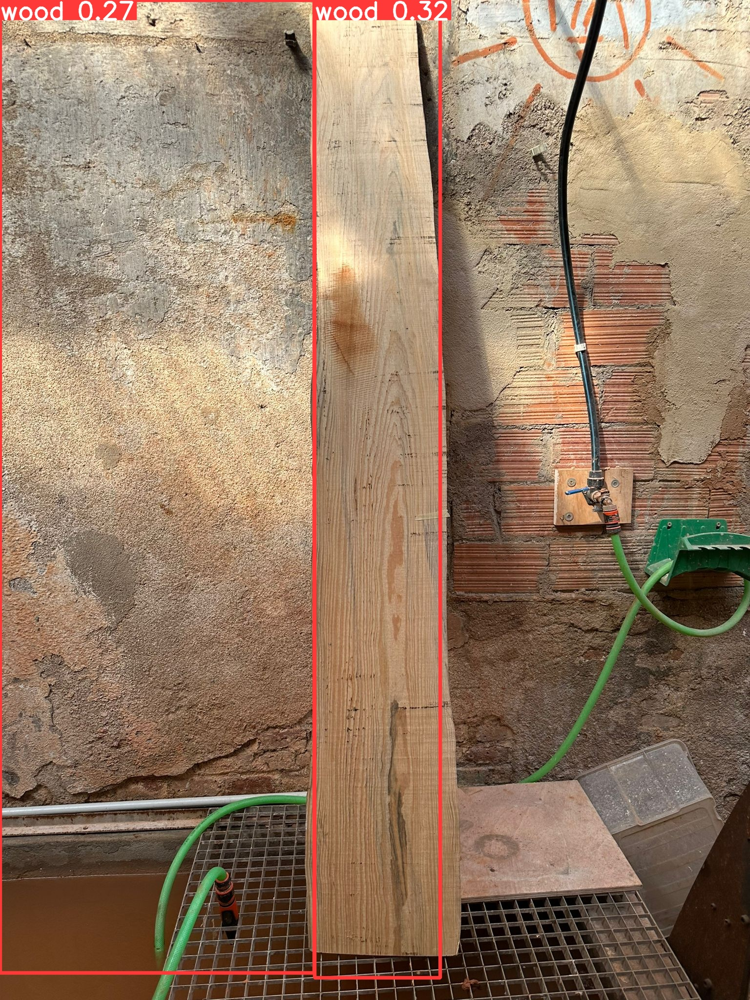

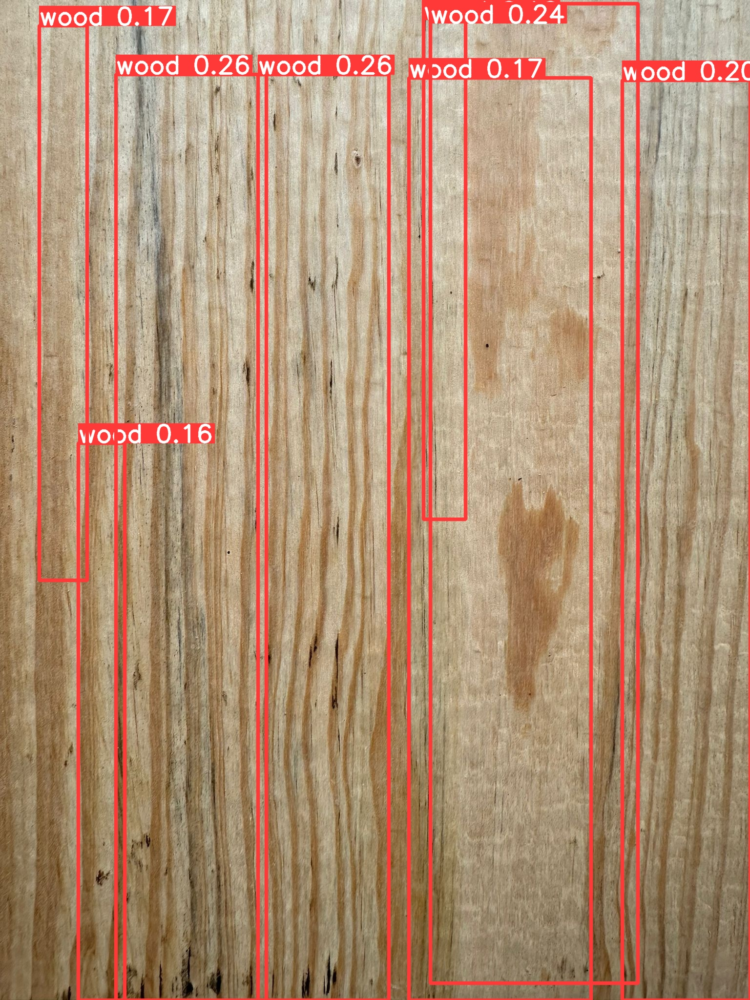

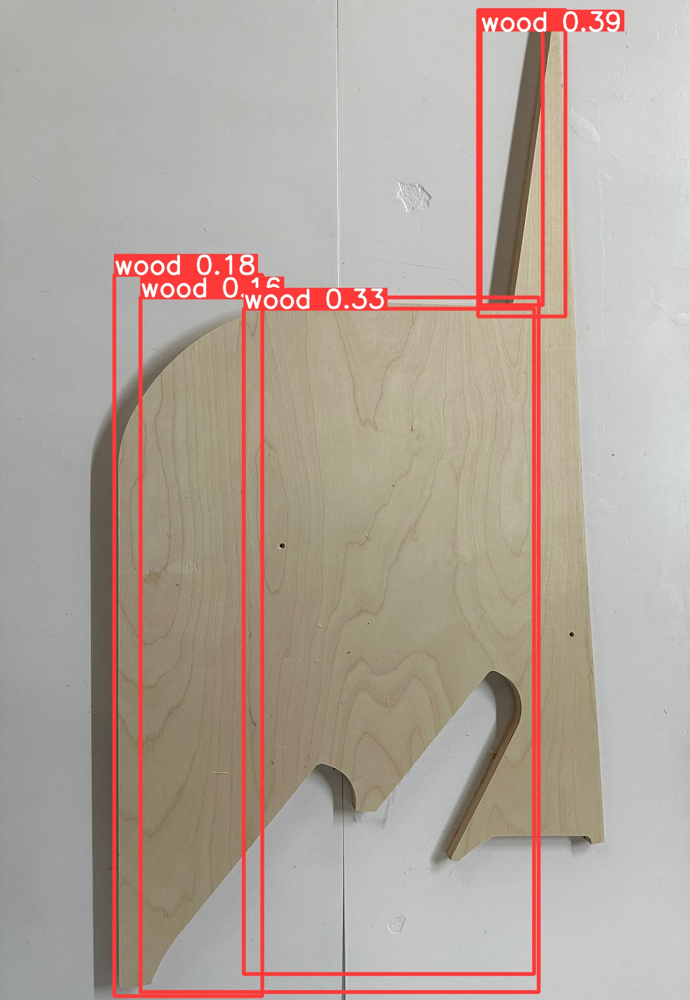

In [ ]:
import glob
from IPython.display import Image, display

# Define the directory where your JPG format images are located
directory = "/content/runs/detect/predict"

# Use glob to find all JPG format images in the directory
jpg_files = glob.glob(f"{directory}/*.jpg")

# Display each JPG format image
for jpg_file in jpg_files:
    display(Image(filename=jpg_file))

In [ ]:
%cd {HOME}
!yolo task=detect mode=predict model={HOME}/runs/detect/train/weights/best.pt conf=0.20 source="/content/datasets/Wood-1/a" save=True


/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11125971 parameters, 0 gradients, 28.4 GFLOPs

Traceback (most recent call last):
  File "/usr/local/bin/yolo", line 8, in <module>
    sys.exit(entrypoint())
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/cfg/__init__.py", line 445, in entrypoint
    getattr(model, mode)(**overrides)  # default args from model
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/engine/model.py", line 242, in predict
    return self.predictor.predict_cli(source=source) if is_cli else self.predictor(source=source, stream=stream)
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/engine/predictor.py", line 205, in predict_cli
    for _ in gen:  # running CLI inference without accumulating any outputs (do not modify)
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/_contextlib.py", line 35, in generator_context
    response = gen.send(

In [ ]:
import glob
from IPython.display import Image, display

# Define the directory where your JPG format images are located
directory = "/content/runs/detect/predict6"
# Use glob to find all JPG format images in the directory
jpg_files = glob.glob(f"{directory}/*.jpg")

# Display each JPG format image
for jpg_file in jpg_files:
    display(Image(filename=jpg_file))

## **DOWNLOAD PREDICT FILE (IMAGES)**

---



---



In [ ]:
import glob
import zipfile

# Define the directory where your JPG format images are located
directory = "/content/runs/detect/predict"

# Use glob to find all JPG format images in the directory
jpg_files = glob.glob(f"{directory}/*.jpg")

# Define the name for the zip file
zip_file_name = "images.zip"

# Create a zip file
with zipfile.ZipFile(zip_file_name, 'w') as zip_file:
    # Add each JPG format image to the zip file
    for jpg_file in jpg_files:
        zip_file.write(jpg_file)

# After the zip file is created, you can download it to your local machine
from google.colab import files
files.download(zip_file_name)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>



---



---
## WOOD - DEFECTS (DATA SET)


In [ ]:
import os
HOME1 = os.getcwd()
print(HOME1)

/content


In [ ]:
# Pip install method (recommended)

!pip install ultralytics==8.0.196

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (8 CPUs, 51.0 GB RAM, 27.0/201.2 GB disk)


In [ ]:
from ultralytics import YOLO

from IPython.display import display, Image

In [ ]:
!mkdir {HOME1}/datasets
%cd {HOME1}/datasets
!mkdir {HOME}/datasets
%cd {HOME}/datasets
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="70KVCANfN8TojfJfSOLw")
project = rf.workspace("wood-type-detection").project("wood-types")
version = project.version(3)
dataset = version.download("yolov8")


mkdir: cannot create directory ‘/content/datasets’: File exists
/content/datasets
mkdir: cannot create directory ‘/content/datasets’: File exists
/content/datasets
loading Roboflow workspace...
loading Roboflow project...


In [ ]:
!mkdir {HOME}/datasets
%cd {HOME}/datasets
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="feQl9ftzHBNMMAygMn4b")
project = rf.workspace("babulal-agrawal-xcfdx").project("wood-defect-detection-jvj8f")
version = project.version(1)
dataset = version.download("yolov8")


mkdir: cannot create directory ‘/content/datasets’: File exists
/content/datasets
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Wood-defect-detection-1 in yolov8:: 100%|██████████| 58584/58584 [00:23<00:00, 2474.37it/s] 


In [ ]:
%cd {HOME1}

!yolo task=detect mode=train model=yolov8s.pt data="/content/datasets/Wood-defect-detection-1/data.yaml" epochs=2 imgsz=800 plots=True

[Errno 2] No such file or directory: '{HOME1}'
/content
New https://pypi.org/project/ultralytics/8.1.27 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/datasets/Wood-defect-detection-1/data.yaml, epochs=2, patience=50, batch=16, imgsz=800, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_str

In [ ]:
%cd {HOME}

!yolo task=detect mode=val model="/content/Wood-types-3/datasets/runs/detect/train5/weights/best.pt" data="/content/Wood-types-3/datasets/Wood-types-3/data.yaml"

[Errno 2] No such file or directory: '{HOME}'
/content
Traceback (most recent call last):
  File "/usr/local/bin/yolo", line 8, in <module>
    sys.exit(entrypoint())
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/cfg/__init__.py", line 420, in entrypoint
    model = YOLO(model, task=task)
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/engine/model.py", line 97, in __init__
    self._load(model, task)
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/engine/model.py", line 149, in _load
    self.model, self.ckpt = attempt_load_one_weight(weights)
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/nn/tasks.py", line 628, in attempt_load_one_weight
    ckpt, weight = torch_safe_load(weight)  # load ckpt
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/nn/tasks.py", line 567, in torch_safe_load
    return torch.load(file, map_location='cpu'), file  # load
  File "/usr/local/lib/python3.10/dist-packages/torch/serialization.py", line 9

In [ ]:
!ls /content/runs/detect/train4

args.yaml					     PR_curve.png	    val_batch0_pred.jpg
confusion_matrix_normalized.png			     R_curve.png	    val_batch1_labels.jpg
confusion_matrix.png				     results.csv	    val_batch1_pred.jpg
events.out.tfevents.1710243397.bf9a11da7132.23603.0  results.png	    val_batch2_labels.jpg
F1_curve.png					     train_batch0.jpg	    val_batch2_pred.jpg
labels_correlogram.jpg				     train_batch1.jpg	    weights
labels.jpg					     train_batch2.jpg
P_curve.png					     val_batch0_labels.jpg


/content/datasets/Wood-defect-detection-1


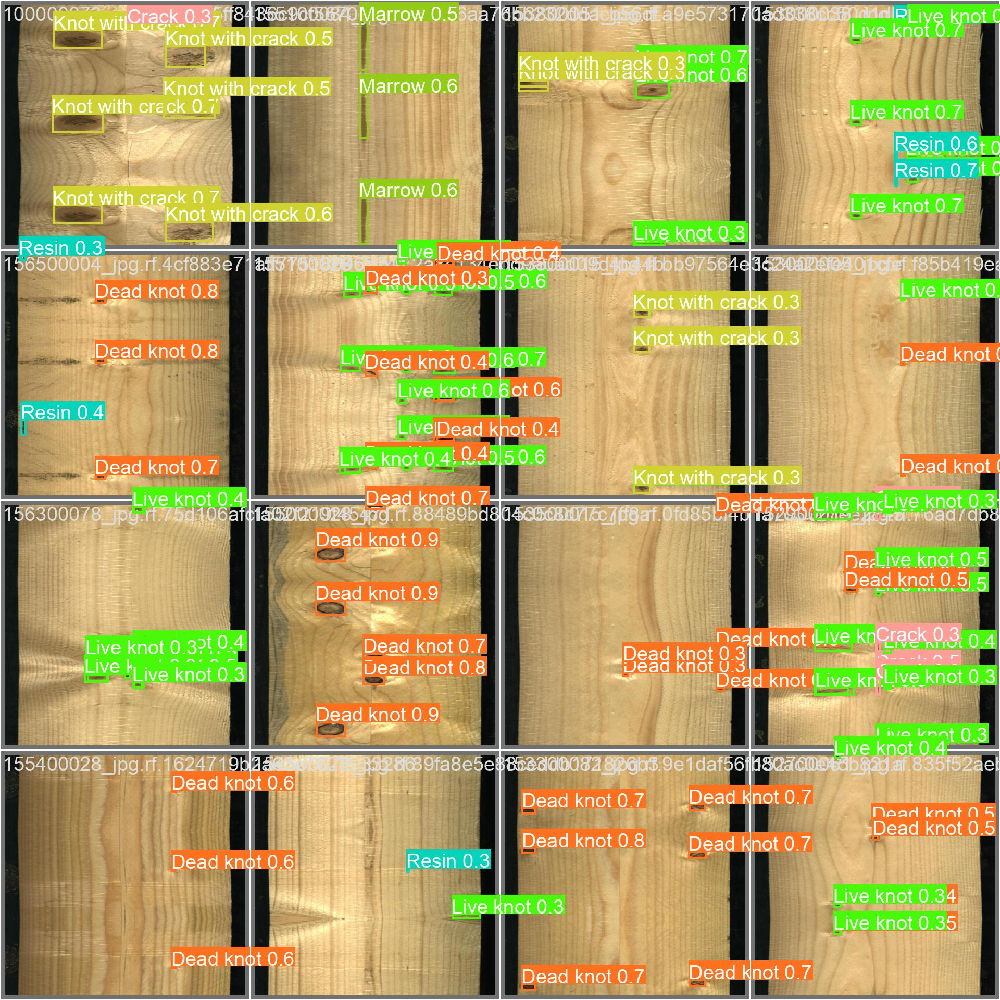

In [ ]:
from IPython.display import Image

# Change the directory
%cd /content/datasets/Wood-defect-detection-1

# Display the image
Image(filename='/content/runs/detect/train4/val_batch0_pred.jpg', width=800)

In [ ]:
%cd {HOME}
!yolo task=detect mode=predict model="/content/runs/detect/train4/weights/best.pt" conf=0.25 source=/content/datasets/Wood-defect-detection-1/test/images save=True

[Errno 2] No such file or directory: '{HOME}'
/content/datasets/Wood-defect-detection-1
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11129454 parameters, 0 gradients, 28.5 GFLOPs

image 1/203 /content/datasets/Wood-defect-detection-1/test/images/100100031_jpg.rf.c8ca572f2d752b352c7b203a5243199c.jpg: 800x800 3 Dead knots, 4 Live knots, 22.5ms
image 2/203 /content/datasets/Wood-defect-detection-1/test/images/100200002_jpg.rf.e86382aab16e123336817d17ec64752e.jpg: 800x800 5 Dead knots, 3 Live knots, 22.6ms
image 3/203 /content/datasets/Wood-defect-detection-1/test/images/100500044_jpg.rf.b36e6f9cdc6192fec5515085c6511014.jpg: 800x800 (no detections), 22.5ms
image 4/203 /content/datasets/Wood-defect-detection-1/test/images/100700031_jpg.rf.b1a0cbbb2a2458abaf1fab7fd5629026.jpg: 800x800 2 Live knots, 22.5ms
image 5/203 /content/datasets/Wood-defect-detection-1/test/images/100700041_jpg.rf.556fb324e47a06da821231efc464

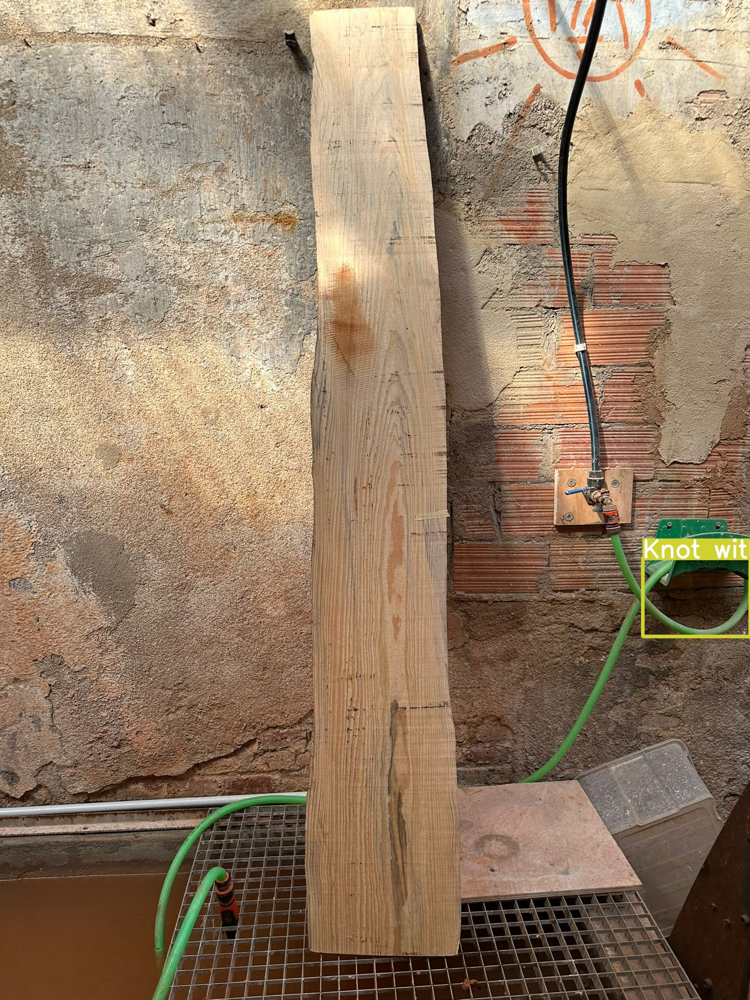

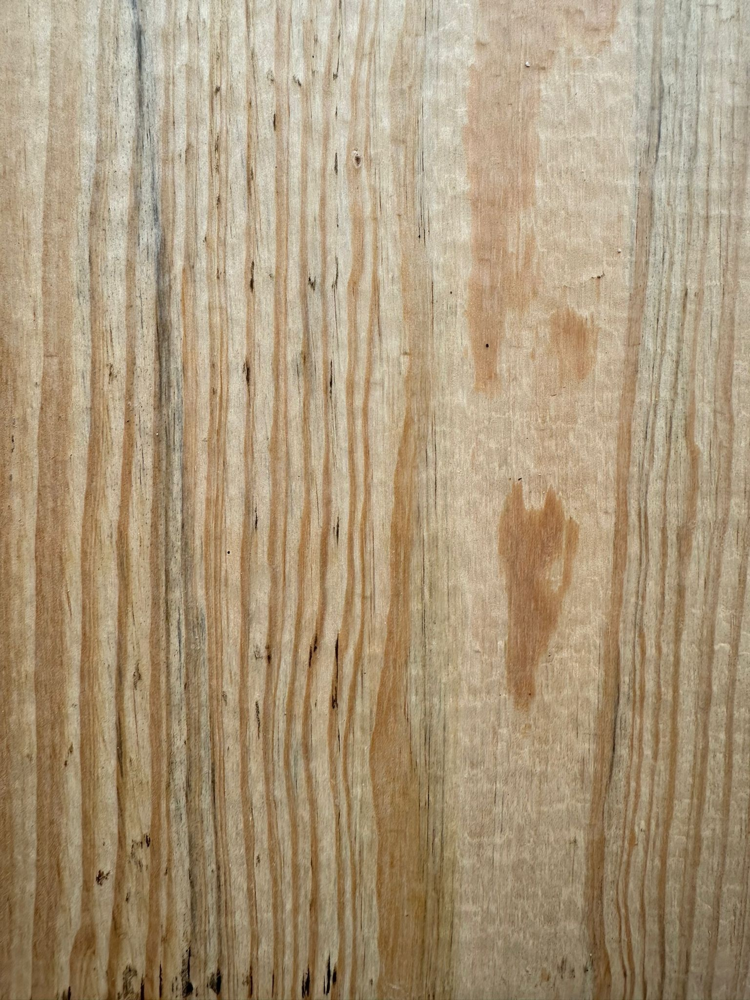

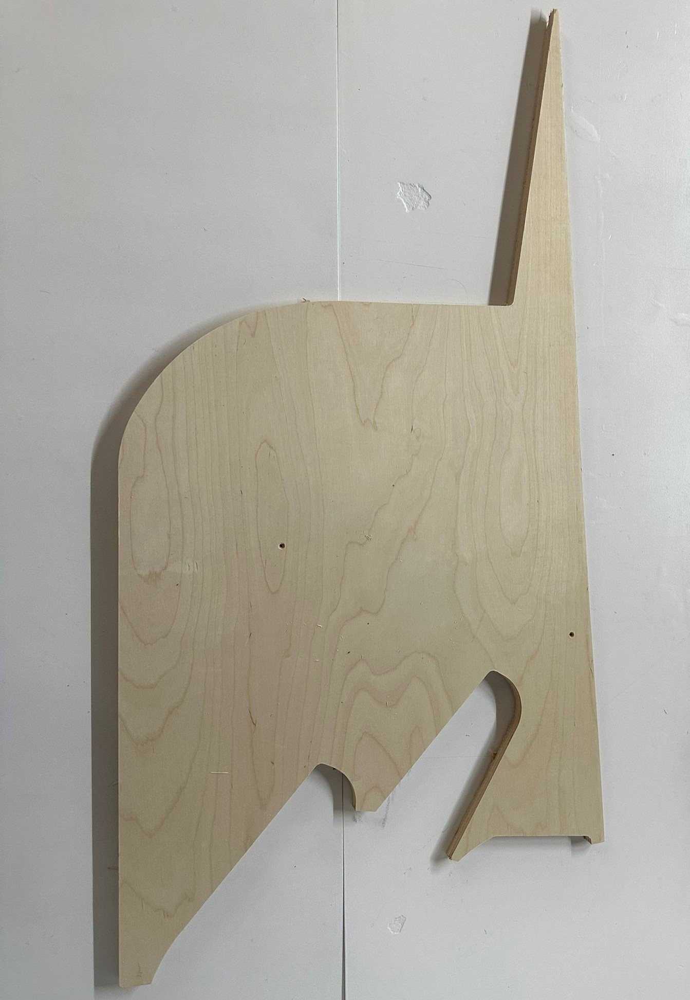

In [ ]:
import glob
from IPython.display import Image, display

# Define the directory where your JPG format images are located
directory = "/content/datasets/Wood-defect-detection-1/runs/detect/predict"

# Use glob to find all JPG format images in the directory
jpg_files = glob.glob(f"{directory}/*.jpg")

# Display each JPG format image
for jpg_file in jpg_files:
    display(Image(filename=jpg_file))


In [ ]:
!pip install torch torchvision
!pip install 'git+https://github.com/facebookresearch/detectron2.git'


  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-j6z4cvno
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-j6z4cvno
  Resolved https://github.com/facebookresearch/detectron2.git to commit cc9266c2396d5545315e3601027ba4bc28e8c95b
  Preparing metadata (setup.py) ... done
  Using cached yacs-0.1.8-py3-none-any.whl (14 kB)
  Using cached fvcore-0.1.5.post20221221.tar.gz (50 kB)
  Preparing metadata (setup.py) ... done
  Using cached iopath-0.1.9-py3-none-any.whl (27 kB)
  Using cached omegaconf-2.3.0-py3-none-any.whl (79 kB)
  Using cached hydra_core-1.3.2-py3-none-any.whl (154 kB)
  Using cached black-24.2.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (1.7 MB)
  Using cached antlr4-python3-runtime-4.9.3.tar.gz (117 kB)
  Preparing metadata (setup.py) ... done
  Using cached portalocker-2.8.2-py3-none-any.whl (17 kB)
  Using cached mypy_extensions-1.0.0-py3-none-any.

In [ ]:
import torch
import torchvision
import detectron2
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
import cv2
import glob

# Prepare the configuration for the model
cfg = get_cfg()
cfg.MODEL.DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
cfg.merge_from_file("detectron2/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set threshold for this model
cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl"  # Pre-trained weights

# Create predictor
predictor = DefaultPredictor(cfg)

# Define the directory where your JPG format images are located
directory = "/content/datasets/Wood-defect-detection-1/runs/detect/predict"

# Use glob to find all JPG format images in the directory
jpg_files = glob.glob(f"{directory}/*.jpg")

# Perform inference and display results
for jpg_file in jpg_files:
    im = cv2.imread(jpg_file)
    outputs = predictor(im)

    # Visualize the predictions
    v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    # Display the predictions
    cv2.imshow("Predictions", v.get_image()[:, :, ::-1])
    cv2.waitKey(0)
    cv2.destroyAllWindows()

    # Get bounding box coordinates
    instances = outputs["instances"]
    boxes = instances.pred_boxes.tensor.numpy()
    print("Bounding Box Coordinates:")
    print(boxes)


ModuleNotFoundError: No module named 'detectron2'

## DOWNLOAD (ZIP)

---



---



In [ ]:
import glob
import zipfile

# Define the directory where your JPG format images are located
directory = "/content/datasets/Wood-defect-detection-1/runs/detect/predict"

# Use glob to find all JPG format images in the directory
jpg_files = glob.glob(f"{directory}/*.jpg")

# Define the name for the zip file
zip_file_name = "images.zip"

# Create a zip file
with zipfile.ZipFile(zip_file_name, 'w') as zip_file:
    # Add each JPG format image to the zip file
    for jpg_file in jpg_files:
        zip_file.write(jpg_file)

# After the zip file is created, you can download it to your local machine
from google.colab import files
files.download(zip_file_name)

## CUSTOM IMAGES SET DEFECT DETECTION

---



---



In [ ]:
%cd {HOME}
!yolo task=detect mode=predict model="/content/runs/detect/train4/weights/best.pt" conf=0.25 source=/content/datasets/Wood-defect-detection-1/test/images save=True

In [ ]:
import glob
from IPython.display import Image, display

# Define the directory where your JPG format images are located
directory = "/content/datasets/Wood-defect-detection-1/runs/detect/predict"

# Use glob to find all JPG format images in the directory
jpg_files = glob.glob(f"{directory}/*.jpg")

# Display each JPG format image
for jpg_file in jpg_files:
    display(Image(filename=jpg_file))

## WOOD - CLASS (DATA SET)

---



---



In [ ]:
import os
HOME2 = os.getcwd()
print(HOME2)

/content


In [ ]:
!mkdir {HOME2}/datasets
%cd {HOME2}/datasets
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="70KVCANfN8TojfJfSOLw")
project = rf.workspace("masood").project("wood-w4h97")
version = project.version(6)
dataset = version.download("yolov8")


/content/datasets
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.4/71.4 kB 2.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 10.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 19.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 8.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 33.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 7.9 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.9.0.80
    Uninstalling opencv-python-headless-4.9.0.80:
      Successfully uninstalled opencv-python-headless-4.9.0.80
  Attempting uninstall: idna
    Found existing installation: idna 3.6
    Uninstalling idna-3.6:
      Successfully uninstalled idna-3.6
  Attempting uninstall: cycler
    Found existing installation: cycler 0.12.1
    Uninstalling cycler-0.12.1:
      Successfully uni

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to wood-6 in yolov8:: 100%|██████████| 2698/2698 [00:00<00:00, 8523.88it/s]


In [ ]:
%cd /content/datasets

!yolo task=detect mode=train model=yolov8s.pt data="/content/datasets/wood-6/data.yaml" epochs=25 imgsz=800 plots=True

/content/datasets
100% 21.5M/21.5M [00:00<00:00, 441MB/s]
New https://pypi.org/project/ultralytics/8.1.27 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/datasets/wood-6/data.yaml, epochs=25, patience=50, batch=16, imgsz=800, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_

In [ ]:
%cd {HOME}

!yolo task=detect mode=val model="/content/datasets/runs/detect/train/weights/best.pt" data="/content/datasets/wood-6/data.yaml"

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11128680 parameters, 0 gradients, 28.5 GFLOPs
val: Scanning /content/datasets/wood-6/valid/labels.cache... 155 images, 0 backgrounds, 0 corrupt: 100% 155/155 [00:00<?, ?it/s]
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 250, len(boxes) = 438. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 10/10 [00:06<00:00,  1.55it/s]
                   all        155        438       0.56      0.523      0.502      0.326
             chipboard        155         13      0.584      0.863      0.746      0.532
            fiberboard        155         33      0.774      0.424      0.531      0.341
               plywood      

/content/datasets/wood-6


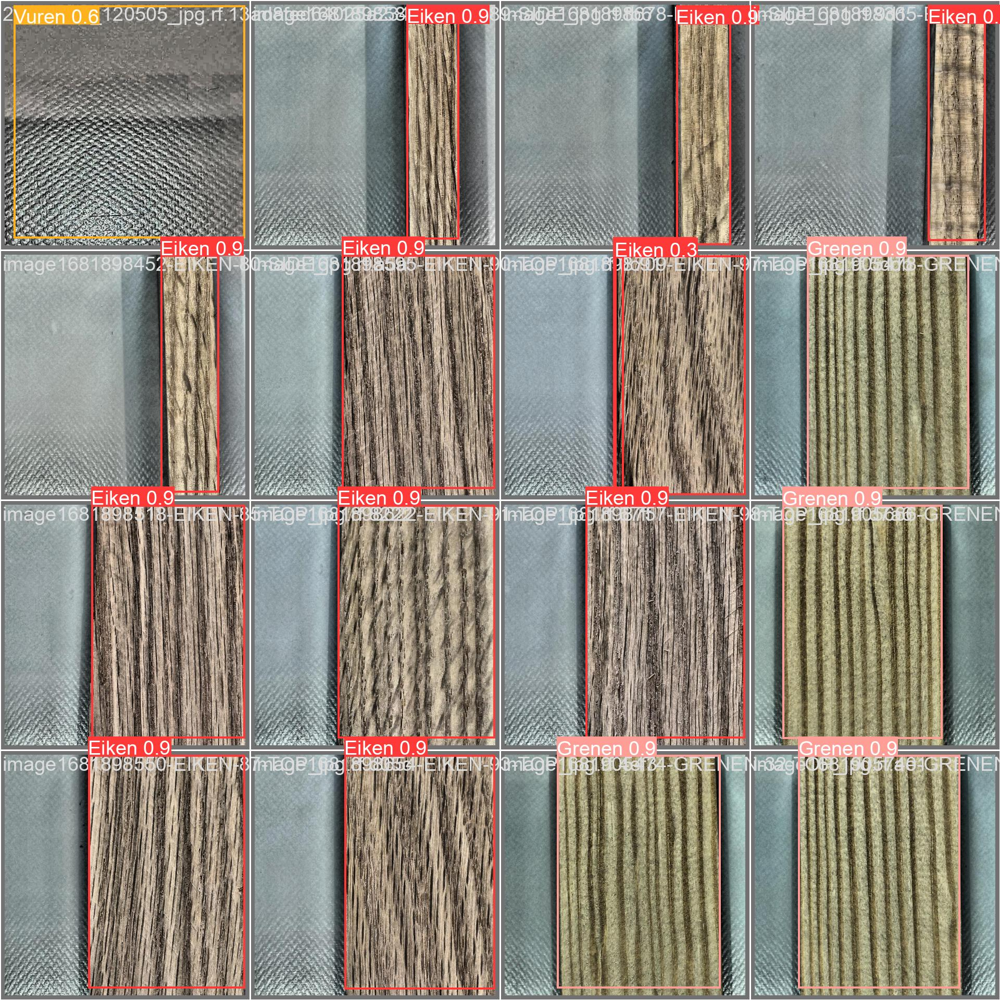

In [ ]:
from IPython.display import Image

# Change the directory
%cd /content/datasets/wood-6

# Display the image
Image(filename='/content/datasets/runs/detect/train/val_batch0_pred.jpg', width=800)


In [ ]:
%cd {HOME}
!yolo task=detect mode=predict model="/content/datasets/runs/detect/train/weights/best.pt" conf=0.25 source=/content/datasets/wood-6/test/images save=True

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11128680 parameters, 0 gradients, 28.5 GFLOPs

image 1/60 /content/datasets/wood-6/test/images/20200815_092325-scaled_jpg.rf.f5ecf60d142ed21a57fdd08a5dcdafdf.jpg: 800x800 3 pressure treated woods, 22.5ms
image 2/60 /content/datasets/wood-6/test/images/51-JlnU14YL-_AC_SY450__jpg.rf.9567a7ce2f23a36395413e74919cb613.jpg: 800x800 2 fiberboards, 1 plywood, 22.6ms
image 3/60 /content/datasets/wood-6/test/images/5972834573794df78b09d6fc5f8f8f28_jpg.rf.ce6d484877640872e58e0a8c9f6d97ba.jpg: 800x800 1 pressure treated wood, 1 timber, 3 tree remainss, 22.5ms
image 4/60 /content/datasets/wood-6/test/images/71kmWj3FQ-L-_SL1500__jpg.rf.09a87d6227f6e7e07bed55c7a8fecafc.jpg: 800x800 1 fiberboard, 2 plywoods, 22.4ms
image 5/60 /content/datasets/wood-6/test/images/Birch-Ply_jpg.rf.514a8fa5489eca1c641be8b44e7a5b54.jpg: 800x800 6 plywoods, 22.2ms
image 6/60 /content/datasets/

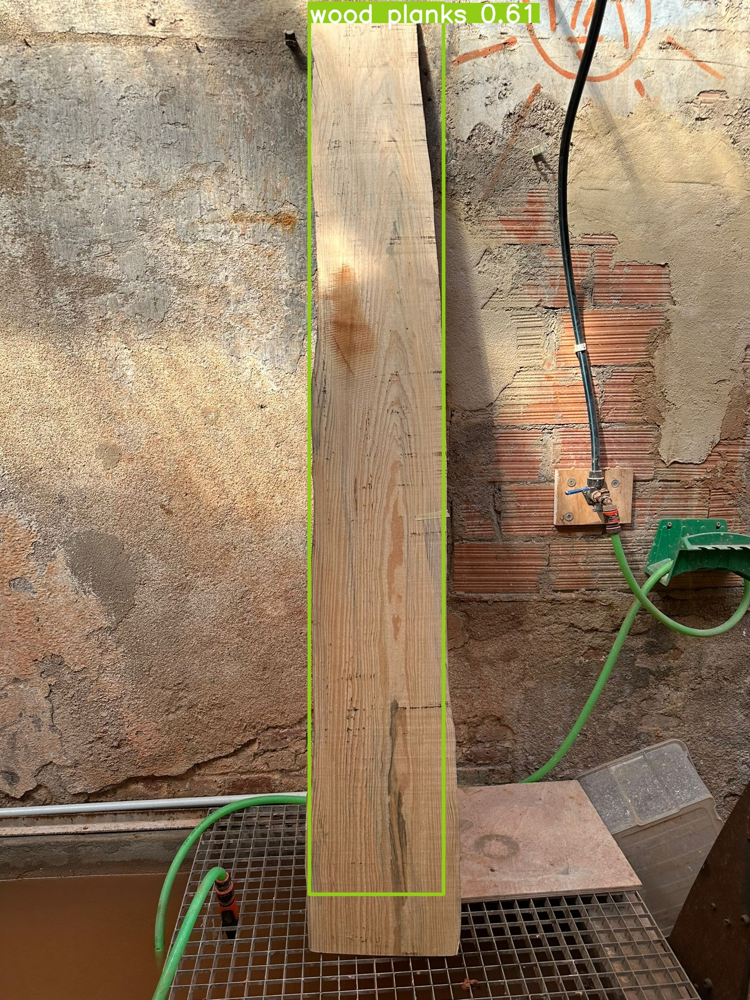

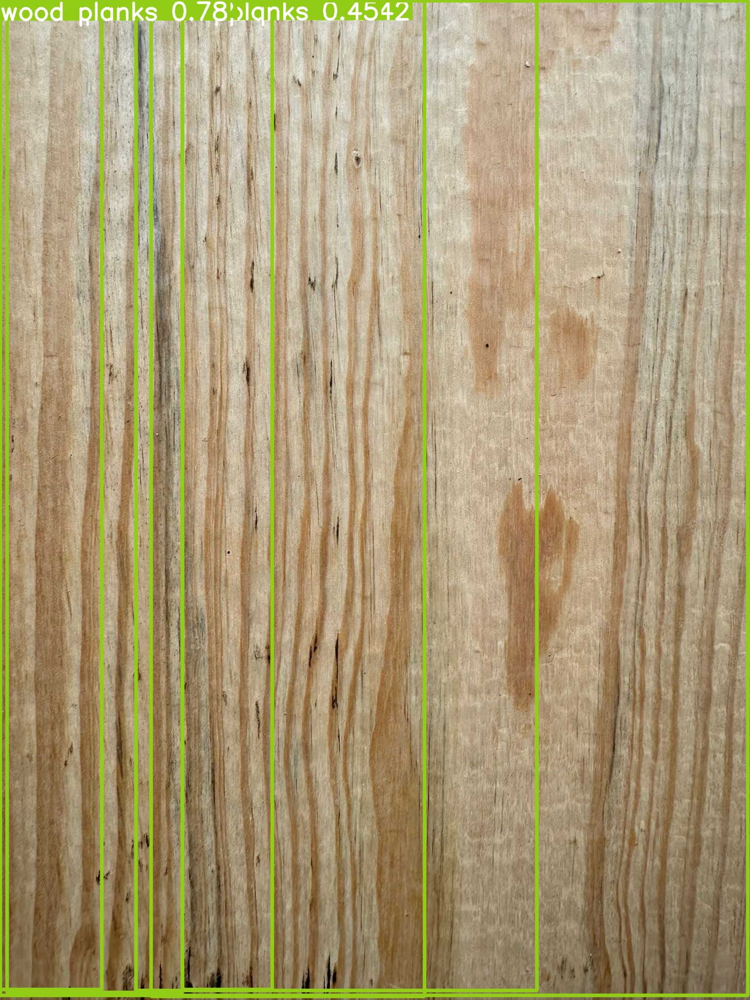

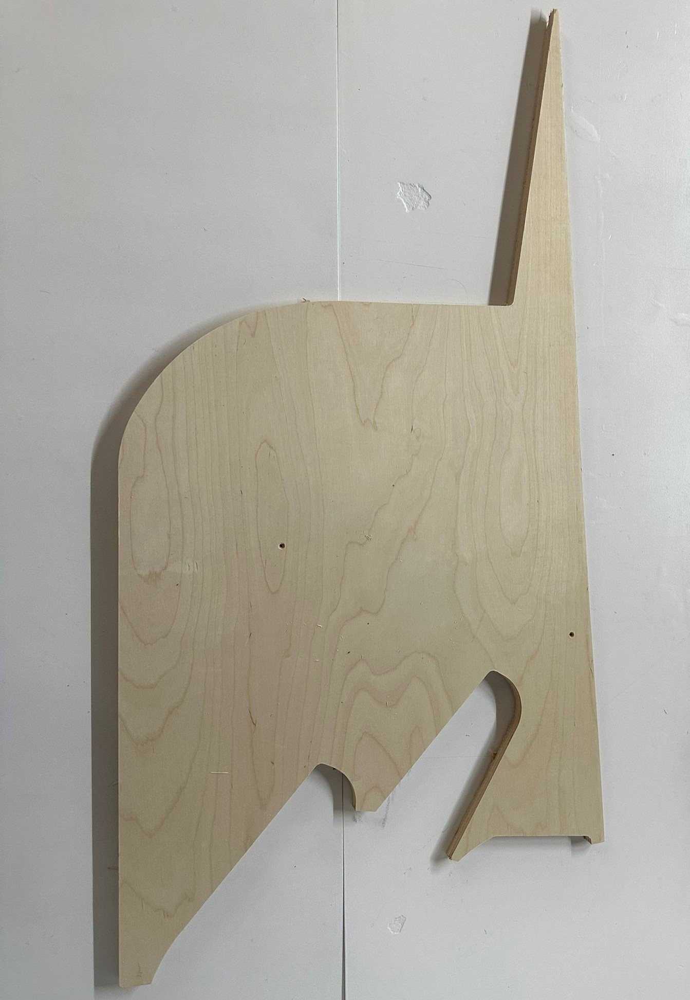

In [ ]:
import glob
from IPython.display import Image, display

# Define the directory where your JPG format images are located
directory = "/content/runs/detect/predict"

# Use glob to find all JPG format images in the directory
jpg_files = glob.glob(f"{directory}/*.jpg")

# Display each JPG format image
for jpg_file in jpg_files:
    display(Image(filename=jpg_file))


In [ ]:
import glob
import zipfile

# Define the directory where your JPG format images are located
directory = "/content/runs/detect/predict"

# Use glob to find all JPG format images in the directory
jpg_files = glob.glob(f"{directory}/*.jpg")

# Define the name for the zip file
zip_file_name = "images.zip"

# Create a zip file
with zipfile.ZipFile(zip_file_name, 'w') as zip_file:
    # Add each JPG format image to the zip file
    for jpg_file in jpg_files:
        zip_file.write(jpg_file)

# After the zip file is created, you can download it to your local machine
from google.colab import files
files.download(zip_file_name)

## TABLE CODE

---



---



╒════╤══════════════╤═════════════════════════╤═══════════════════════════════════╤═══════════════════════════════════╕
│    │ Image Path   │ Wood Detection          │ Wood Classification               │ Wood Defects                      │
╞════╪══════════════╪═════════════════════════╪═══════════════════════════════════╪═══════════════════════════════════╡
│  0 │ /IMAGE1.jpg  │ 800x608 8 woods, 67.5ms │ 800x608 1 Vuren, 69.5ms           │ 800x608 (no detections), 69.3ms   │
├────┼──────────────┼─────────────────────────┼───────────────────────────────────┼───────────────────────────────────┤
│  1 │ /IMAGE2.jpg  │ 800x608 2 woods, 19.6ms │ 800x608 1 Eiken, 1 Grenen, 19.6ms │ 800x608 1 Knot with crack, 19.7ms │
├────┼──────────────┼─────────────────────────┼───────────────────────────────────┼───────────────────────────────────┤
│  2 │ /IMAGE3.jpg  │ 800x576 5 woods, 67.1ms │ 800x576 1 Vuren, 67.1ms           │ 800x576 (no detections), 68.2ms   │
╘════╧══════════════╧═══════════════════

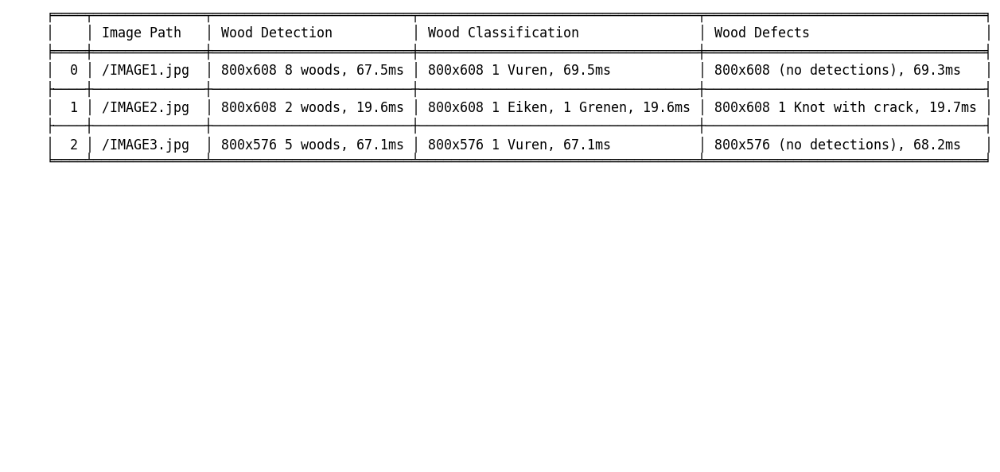

In [ ]:
import pandas as pd
from tabulate import tabulate
import matplotlib.pyplot as plt

# Output of wood detection
wood_detection_output = """
/IMAGE1.jpg: 800x608 8 woods, 67.5ms
/IMAGE2.jpg: 800x608 2 woods, 19.6ms
/IMAGE3.jpg: 800x576 5 woods, 67.1ms
"""

# Output of wood classification
wood_classification_output = """
/IMAGE1.jpg: 800x608 1 Vuren, 69.5ms
/IMAGE2.jpg: 800x608 1 Eiken, 1 Grenen, 19.6ms
/IMAGE3.jpg: 800x576 1 Vuren, 67.1ms
"""

# Output of wood defects
wood_defects_output = """
/IMAGE1.jpg: 800x608 (no detections), 69.3ms
/IMAGE2.jpg: 800x608 1 Knot with crack, 19.7ms
/IMAGE3.jpg: 800x576 (no detections), 68.2ms
"""

# Initialize lists to store data
image_paths = []
wood_detection_labels = []
wood_classification_labels = []
wood_defects_labels = []

# Parse wood detection output
for line in wood_detection_output.strip().split('\n'):
    parts = line.split(':')
    image_path = parts[0].strip()
    wood_detection_label = parts[1].strip()
    image_paths.append(image_path)
    wood_detection_labels.append(wood_detection_label)

# Parse wood classification output
for line in wood_classification_output.strip().split('\n'):
    parts = line.split(':')
    image_path = parts[0].strip()
    wood_classification_label = parts[1].strip()
    wood_classification_labels.append(wood_classification_label)

# Parse wood defects output
for line in wood_defects_output.strip().split('\n'):
    parts = line.split(':')
    image_path = parts[0].strip()
    wood_defects_label = parts[1].strip()
    wood_defects_labels.append(wood_defects_label)

# Create a DataFrame
data = {
    'Image Path': image_paths,
    'Wood Detection': wood_detection_labels,
    'Wood Classification': wood_classification_labels,
    'Wood Defects': wood_defects_labels
}

df = pd.DataFrame(data)

# Convert DataFrame to tabular format with borders
table = tabulate(df, headers='keys', tablefmt='fancy_grid')

# Plot the table
plt.figure(figsize=(10, 6))
plt.axis('off')  # Hide the axes
plt.text(0.1, 0.9, table, {'fontsize': 12}, fontfamily='monospace')
plt.tight_layout()

# Save the plot as a JPEG image
plt.savefig('output_table.jpg', format='jpeg')

# Display the table
print(table)
